In [1]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("darkgrid")

In [2]:
f = lambda x: x**3-2*x+2
df = lambda x: 3*x**2 - 2
newt = lambda z: z - f(z)/df(z)

In [3]:
z = np.linspace(-2,2,1000)  #instead of one initial guess, we'll try every point on the interval [-2, 2].
reps = 7
arr = np.zeros((len(z),reps+1))  #columns are the iterations of newton's method, the rows represent each initial value (of which there are 1000)
arr[:,0] = z  #same except for using the [:,0] instead of [0]

for i in range(reps):
    arr[:,i+1] = newt(arr[:,i])

In [4]:
results = arr[:,-1]  #last column holds the results, the final x-values from Newton's method

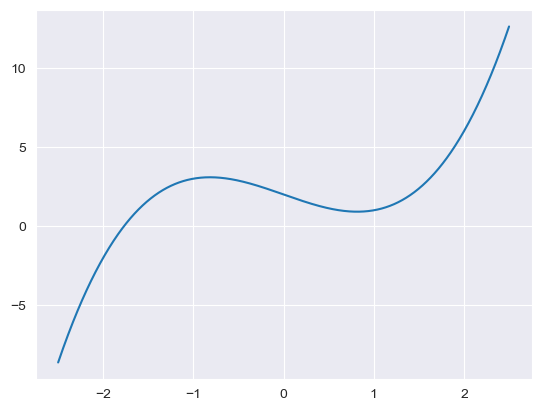

In [5]:
fig,ax = plt.subplots()
x = np.linspace(-2.5,2.5,1000)
ax.plot(x,f(x));

In [6]:
good_bool = np.abs(f(results)) < 0.001   #check the absolute value of the y-values from Newton's method

In [7]:
good_bool.shape

(1000,)

In [8]:
good_bool.sum()

327

ValueError: x and y must have same first dimension, but have shapes (327,) and (1,)

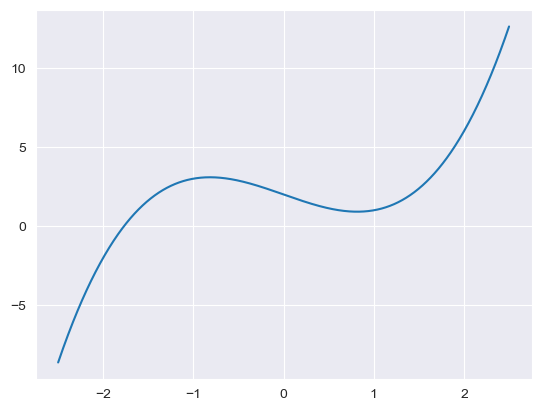

In [9]:
fig,ax = plt.subplots()
x = np.linspace(-2.5,2.5,1000)
pts = z[good_bool]
ax.plot(x,f(x));
ax.plot(pts,0,'ko')


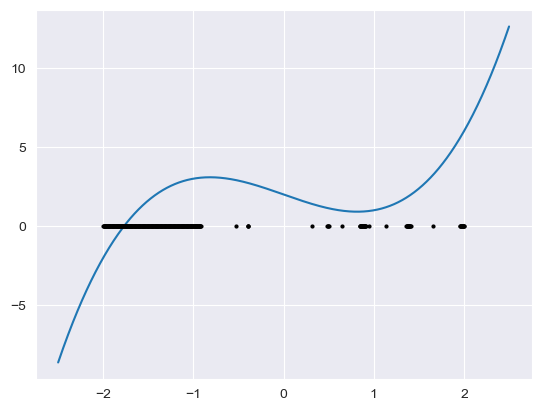

In [10]:
fig,ax = plt.subplots()
x = np.linspace(-2.5,2.5,1000)
pts = z[good_bool]
ax.plot(x,f(x));
ax.plot(pts,np.zeros(len(pts)),'ko',markersize=2);

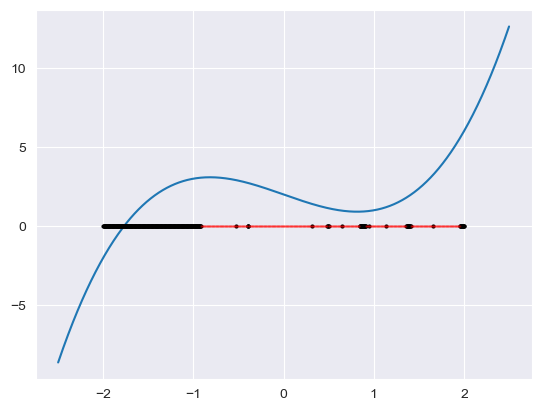

In [11]:
fig,ax = plt.subplots()
x = np.linspace(-2.5,2.5,1000)
pts = z[good_bool]
pts2 = z[~good_bool]
ax.plot(x,f(x));
ax.plot(pts,np.zeros(len(pts)),'ko',markersize=2);
ax.plot(pts2,np.zeros(len(pts2)),'ro',markersize=0.5, alpha = 0.25); #smaller markers so the scattered black markers still show
#alpha determines the transparency of a point. alpha = 0 is totally invisible, and alpha = 1 is totally opaque.

In [12]:
import numpy as np

In [13]:
def bisect(f, x0, x1, tol):  #Almost the same code as in Matlab.
    root = x0
    while np.abs(f(root)) > tol: #when |f(root)| is large, we are far away from the x-axis.
        root = (x0 + x1)/2
        if f(x0)*f(root) < 0: #product is negative if and only if the individual values have opposite signs.
            x1 = root #root is between x0 and root, so replace x1 with root
        else:
            x0 = root
    return root

def newt_while(f, df, x0, tol):   #modified to only take the very end result, and to keep running until we are a certain distance away from the x-axis.
    newt = lambda z: z - f(z)/df(z)
    root = x0
    
    while np.abs(f(root)) > tol: #when |f(root)| is large, we are far away from the x-axis.
        root = newt(root)
    return root

In [14]:
f = lambda x: x**3-2*x+2
df = lambda x: 3*x**2 - 2
x0 = -1.5
x1 = -2
tol = 1e-12   #Try at 1e-3, 1e-8, and 1e-12

In [15]:
%%timeit
bisect(f, x0, x1, tol)

68.2 μs ± 4.78 μs per loop (mean ± std. dev. of 7 runs, 10,000 loops each)


In [16]:
%%timeit
newt_while(f, df, x0, tol)


9.83 μs ± 355 ns per loop (mean ± std. dev. of 7 runs, 100,000 loops each)


In [17]:
import os #operating system, used for accessing files on the computer.

In [18]:
from PIL import Image

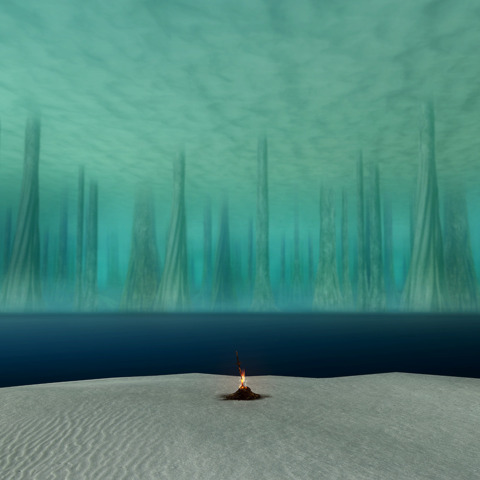

In [19]:
Image.open("ash-lake.png")

In [20]:
os.getcwd() #current working directory

'C:\\Users\\lukea\\Documents\\GitHub\\Math9-WI25\\lectures'

In [21]:
os.listdir()

['.ipynb_checkpoints',
 'ash-lake-crop.png',
 'ash-lake.png',
 'images',
 'lec17_18_19_WI25.ipynb',
 'lec19_20_21_WI25.ipynb',
 'lec22_23_24_WI25.ipynb',
 'lec23_24_FA24.ipynb',
 'lec24_25_26_WI25.ipynb',
 'lec26_27_28_WI25.ipynb']

In [22]:
os.listdir("images") #name of my folder

['12.jpg',
 '13.jpg',
 '14.jpg',
 '15.jpg',
 '16.jpg',
 '17.jpg',
 '18.jpg',
 '19.jpg',
 '20.jpg',
 '21.jpg',
 '22.jpg',
 '23.jpg',
 '24.jpg',
 '25.jpg',
 '26.jpg',
 '27.jpg',
 'anor-londo.png',
 'Cloud.png',
 'magus.webp',
 'MW-place-Ghostgate.jpg',
 'Red_room.jpeg',
 'SI-place-Crucible_Statue.jpg',
 'zeal.webp']

In [23]:
Image.open('Red_room.jpeg')

FileNotFoundError: [Errno 2] No such file or directory: 'C:\\Users\\lukea\\Documents\\GitHub\\Math9-WI25\\lectures\\Red_room.jpeg'

In [24]:
s = os.path.join("images",'Red_room.jpeg')

In [25]:
s

'images\\Red_room.jpeg'

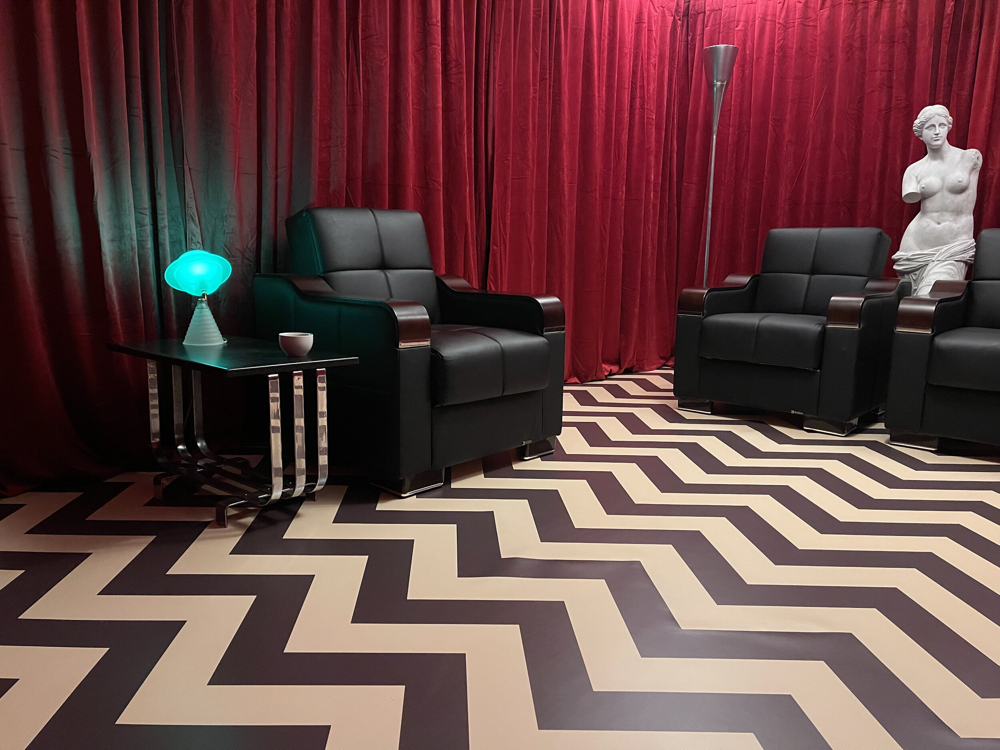

In [26]:
Image.open(s)

In [27]:
os.listdir("images")

['12.jpg',
 '13.jpg',
 '14.jpg',
 '15.jpg',
 '16.jpg',
 '17.jpg',
 '18.jpg',
 '19.jpg',
 '20.jpg',
 '21.jpg',
 '22.jpg',
 '23.jpg',
 '24.jpg',
 '25.jpg',
 '26.jpg',
 '27.jpg',
 'anor-londo.png',
 'Cloud.png',
 'magus.webp',
 'MW-place-Ghostgate.jpg',
 'Red_room.jpeg',
 'SI-place-Crucible_Statue.jpg',
 'zeal.webp']

In [28]:
[x for x in os.listdir("images") if x[-3:] == "jpg"]

['12.jpg',
 '13.jpg',
 '14.jpg',
 '15.jpg',
 '16.jpg',
 '17.jpg',
 '18.jpg',
 '19.jpg',
 '20.jpg',
 '21.jpg',
 '22.jpg',
 '23.jpg',
 '24.jpg',
 '25.jpg',
 '26.jpg',
 '27.jpg',
 'MW-place-Ghostgate.jpg',
 'SI-place-Crucible_Statue.jpg']

In [29]:
[x for x in os.listdir("images") if x.endswith("png")]

['anor-londo.png', 'Cloud.png']

In [30]:
[ x for x in os.listdir("images") if x.endswith("webp") ]

['magus.webp', 'zeal.webp']

In [31]:
type(os.listdir("images"))

list

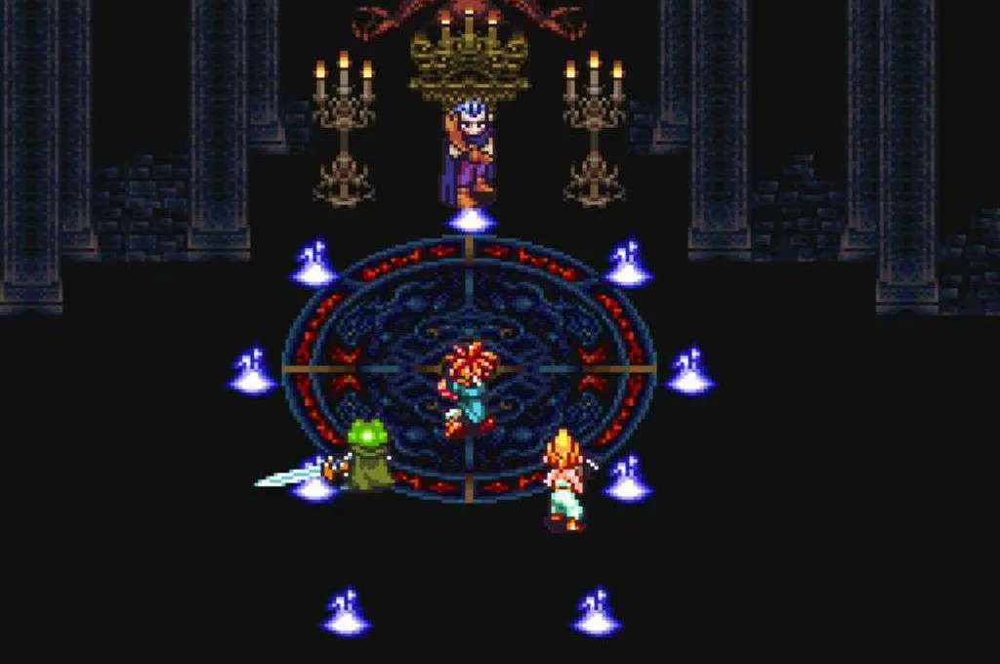

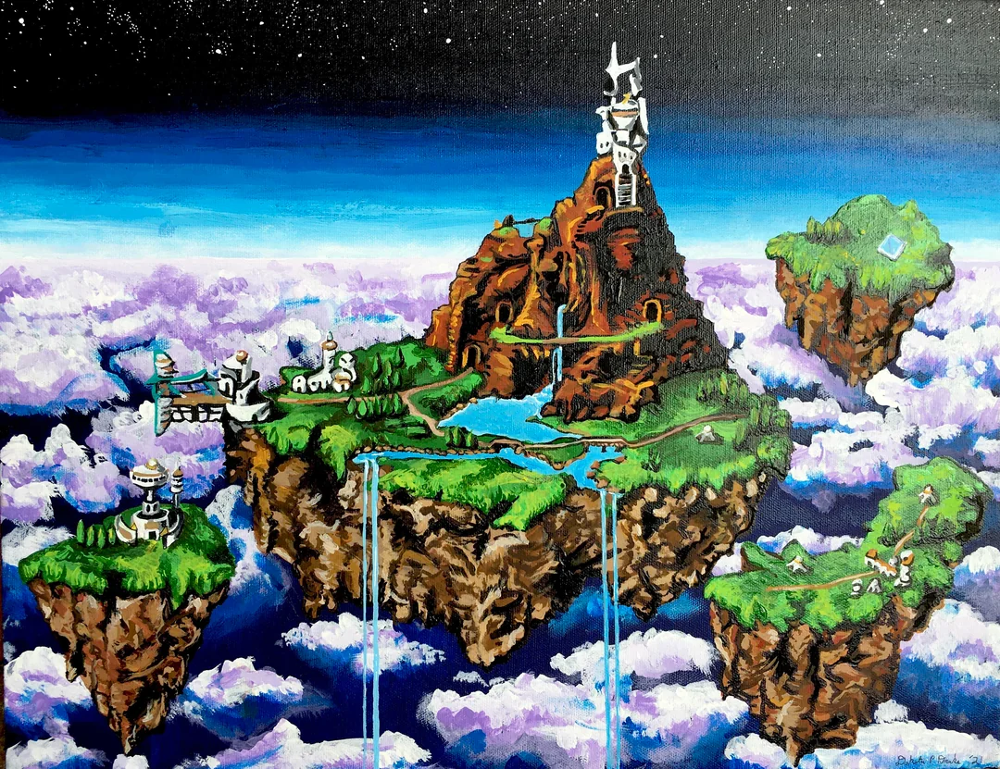

In [32]:
for x in os.listdir("images"):
    if x.endswith("webp"):
        img = Image.open(os.path.join("images",x))
        display(img)

In [33]:
img = Image.open("ash-lake.png")

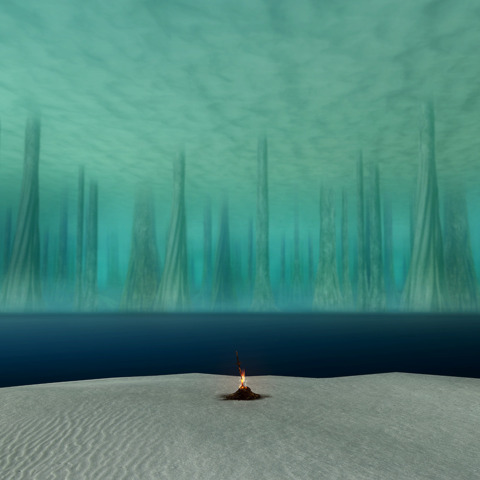

In [34]:
img

In [35]:
type(img)

PIL.PngImagePlugin.PngImageFile

In [36]:
arr = np.asarray(img)

In [37]:
arr

array([[[ 83, 161, 148],
        [ 83, 161, 148],
        [ 83, 161, 148],
        ...,
        [ 94, 157, 140],
        [ 94, 157, 140],
        [ 94, 157, 140]],

       [[ 83, 161, 148],
        [ 83, 161, 148],
        [ 83, 161, 148],
        ...,
        [ 93, 156, 139],
        [ 93, 156, 139],
        [ 93, 156, 139]],

       [[ 83, 161, 148],
        [ 83, 161, 148],
        [ 83, 161, 148],
        ...,
        [ 93, 156, 139],
        [ 92, 155, 138],
        [ 92, 155, 138]],

       ...,

       [[117, 128, 120],
        [140, 151, 143],
        [152, 163, 155],
        ...,
        [113, 126, 119],
        [117, 130, 123],
        [121, 134, 127]],

       [[128, 139, 131],
        [129, 140, 132],
        [124, 135, 127],
        ...,
        [112, 125, 118],
        [114, 127, 120],
        [116, 129, 122]],

       [[130, 141, 133],
        [118, 129, 121],
        [105, 117, 107],
        ...,
        [119, 132, 125],
        [120, 133, 126],
        [121, 134, 127]]

In [38]:
type(arr)

numpy.ndarray

In [39]:
arr.shape

(480, 480, 3)

In [40]:
arr[0, 0]

array([ 83, 161, 148], dtype=uint8)

In [41]:
arr.min()

0

In [42]:
arr.max()

255

In [43]:
(arr[:,300:]).shape

(480, 180, 3)

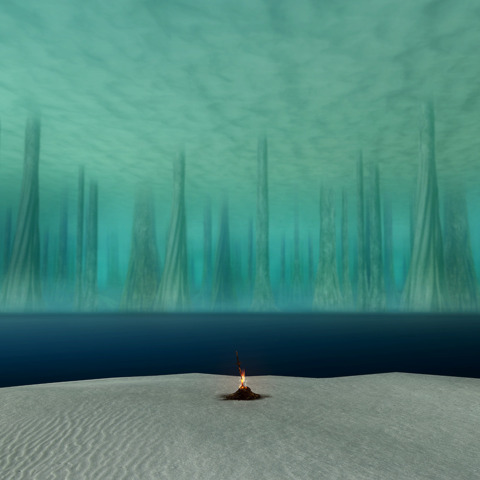

In [44]:
img

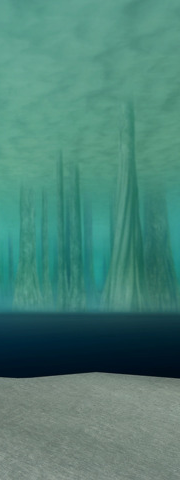

In [45]:
Image.fromarray(arr[:,300:])   #Sliced array gives cropped image

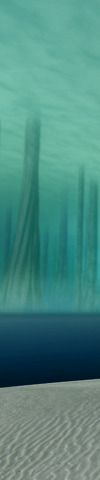

In [46]:
Image.fromarray(arr[:,:100])   #note that the [0,0] pixel is in the upper left corner

In [47]:
arr_no_mid = np.concatenate([arr[:,:100],arr[:,300:]], axis=1) #choose the axis where the array sizes are different.

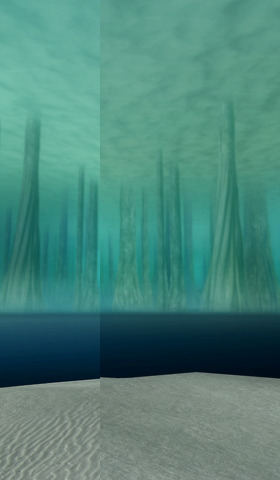

In [48]:
Image.fromarray(arr_no_mid)  #middle of image cropped out

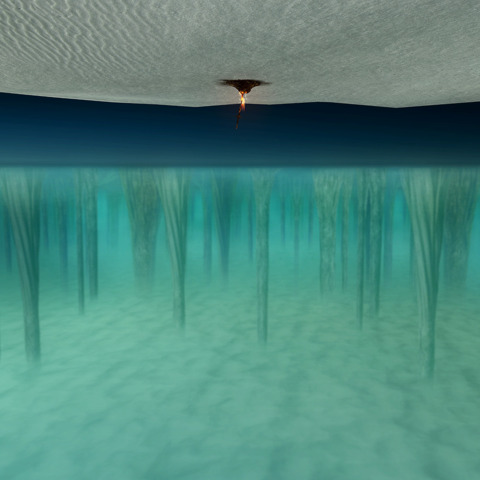

In [49]:
arr_flip = arr[::-1,:,::]
Image.fromarray(arr_flip)

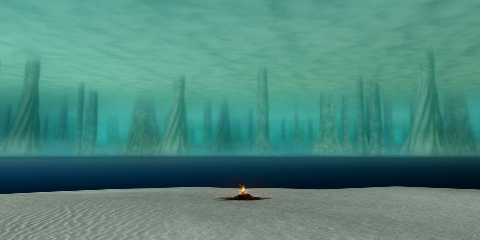

In [50]:
arr_squash = arr[::2,::,::]
Image.fromarray(arr_squash)

images\Red_room.jpeg


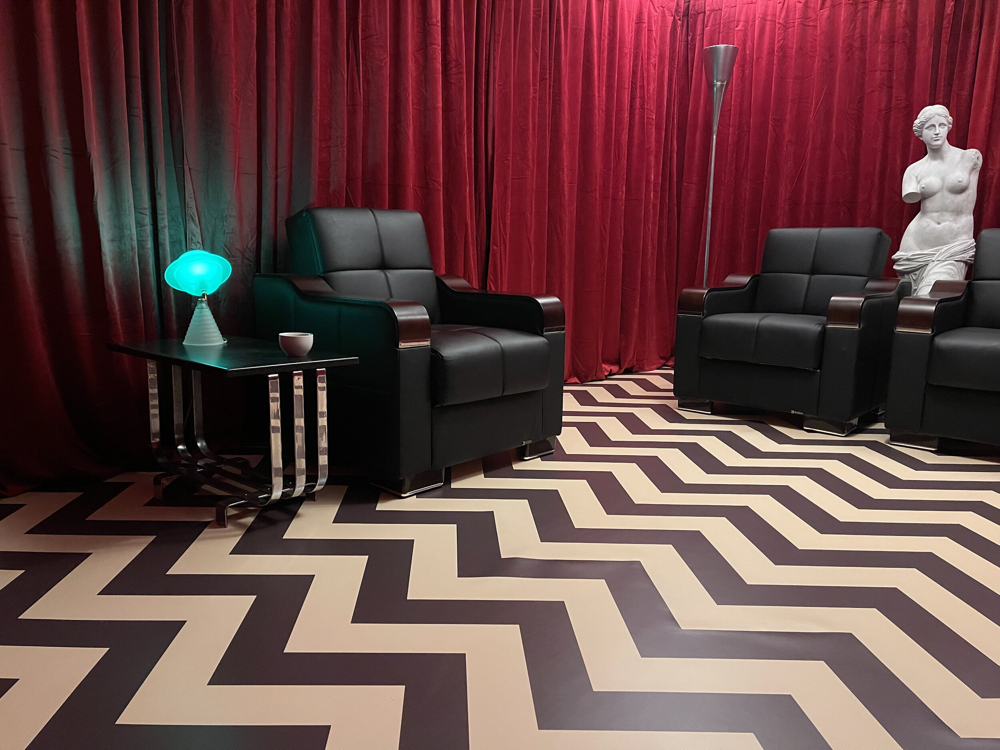

In [51]:
s = os.path.join("images",'Red_room.jpeg')
print(s)
Image.open(s)

In [52]:
arr_red = np.asarray(Image.open(s))
arr_red

array([[[ 80,  25,  31],
        [ 76,  21,  27],
        [ 70,  15,  21],
        ...,
        [148,  52,  63],
        [149,  53,  64],
        [146,  53,  63]],

       [[ 82,  27,  33],
        [ 81,  26,  32],
        [ 79,  24,  30],
        ...,
        [152,  56,  67],
        [152,  56,  67],
        [148,  55,  65]],

       [[ 75,  20,  26],
        [ 79,  24,  30],
        [ 81,  26,  32],
        ...,
        [153,  57,  68],
        [152,  56,  67],
        [146,  53,  63]],

       ...,

       [[175, 143, 122],
        [174, 142, 121],
        [174, 142, 121],
        ...,
        [115, 103, 107],
        [115, 103, 107],
        [115, 103, 107]],

       [[177, 145, 124],
        [175, 143, 122],
        [175, 143, 122],
        ...,
        [114, 102, 106],
        [114, 102, 106],
        [114, 102, 106]],

       [[179, 147, 126],
        [177, 145, 124],
        [176, 144, 123],
        ...,
        [116, 104, 108],
        [116, 104, 108],
        [116, 104, 108]]

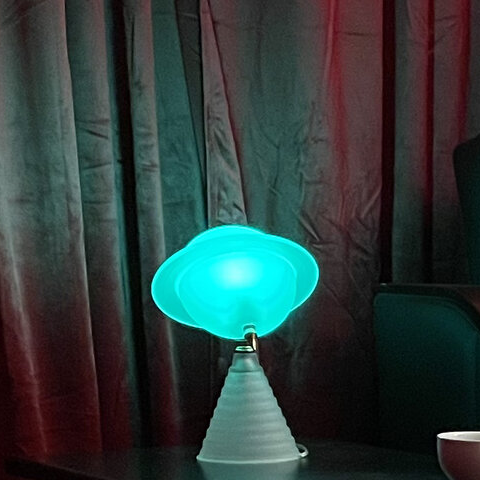

In [53]:
arr_r_crop = arr_red[400:880,260:740]
Image.fromarray(arr_r_crop)

In [54]:
arr_r_crop.shape  #same shape as Ash Lake

(480, 480, 3)

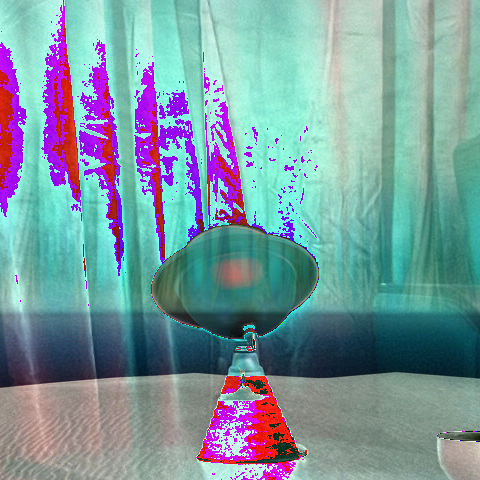

In [55]:
Image.fromarray(arr + arr_r_crop)

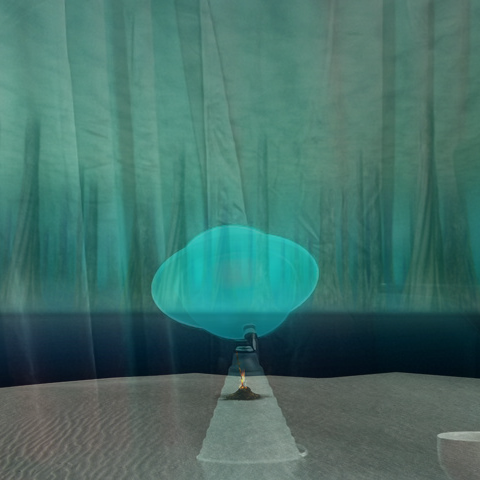

In [56]:
weight=0.3
Image.fromarray(np.uint8((1-weight)*arr + weight*arr_r_crop))  
#change this back to np.uint8 to avoid decimals in final calculation. Some rounding occurs.

(480, 215, 3)


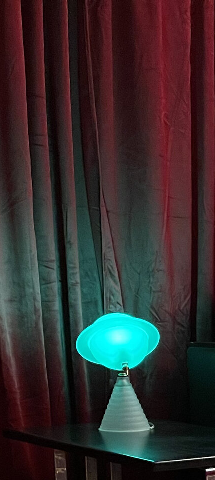

In [57]:
r_crop_scale = arr_red[:960:2,260:690:2]
print(r_crop_scale.shape)
Image.fromarray(r_crop_scale)

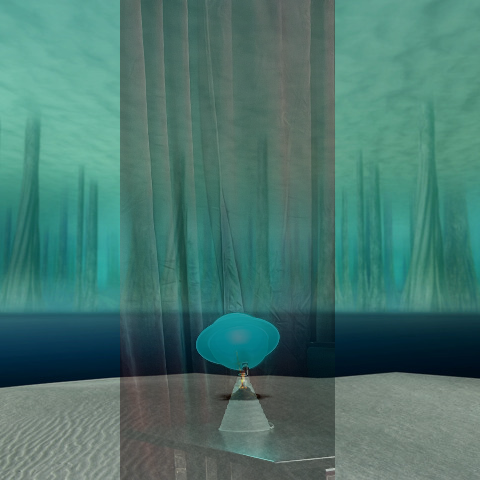

In [58]:
arr_sc = arr.copy()
weight = 0.4
arr_sc[:, 120:335] = np.uint8((1-weight)*arr_sc[:, 120:335] + weight*r_crop_scale)
Image.fromarray(arr_sc)

(480, 480, 3)


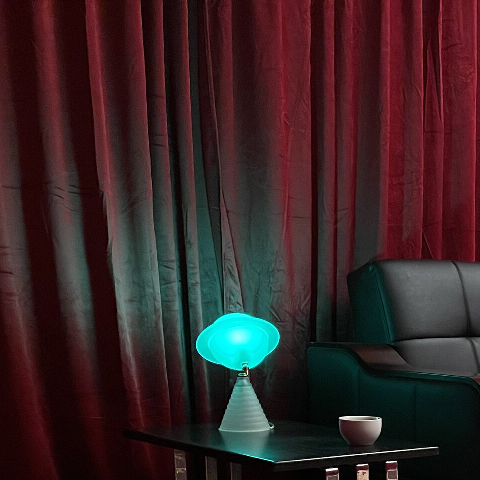

In [59]:
r_crop_scale_2 = arr_red[:960:2,20:980:2]
print(r_crop_scale_2.shape)
Image.fromarray(r_crop_scale_2)

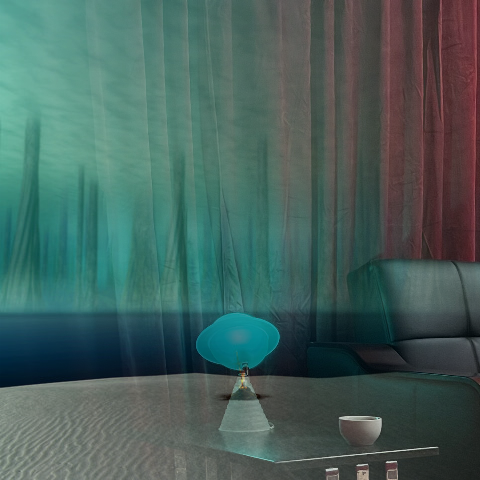

In [60]:
arr_sc2 = arr.copy()
x = np.linspace(0,0.8,480) #480 weights, evenly spaces from 0 to 0.8. Use this for a row of the weights tensor.
x = x.reshape(1,-1, 1) #match the 3-dim tensor structure of our image, using 1 row, 480 columns, and 1 depth.
weights = np.zeros_like(arr, dtype = np.float64)
weights[:,:,:] = x #broadcast x across all rows of our weights tensor.

arr_sc2 = np.uint8((1-weights)*arr + weights*r_crop_scale_2) #same type equation as previous example, thanks to broadcasting.
Image.fromarray(arr_sc2)

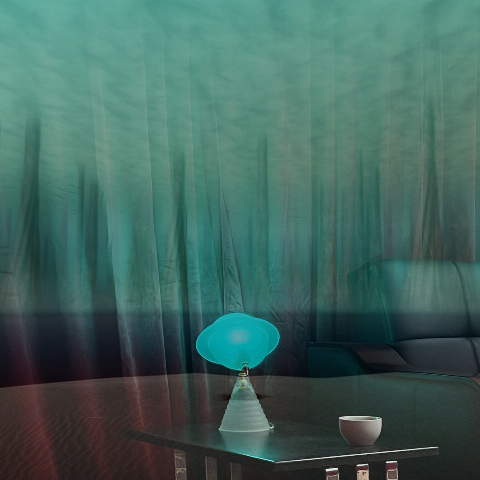

In [61]:
arr_sc3 = arr.copy()
x = np.linspace(0,0.8,480) #480 weights, evenly spaces from 0 to 0.8. Use this for a row of the weights matrix
x = x.reshape(-1,1, 1) #reshape is different in this cell
weights = np.zeros_like(arr, dtype = np.float64)
weights[:,:,:] = x #broadcast x across all columns of our weights tensor.

arr_sc3 = np.uint8((1-weights)*arr + weights*r_crop_scale_2) #same type equation as previous example, thanks to broadcasting.
Image.fromarray(arr_sc3)

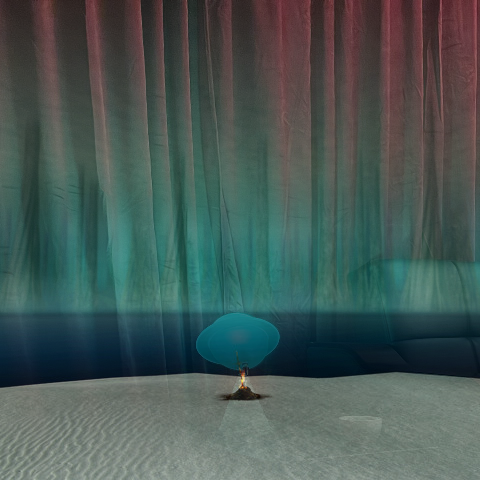

In [62]:
arr_sc4 = arr.copy()
x = np.linspace(0.8,0,480) #480 weights, evenly spaces from 0.8 to 0. Use this for a row of the weights matrix
x = x.reshape(-1,1, 1)
weights = np.zeros_like(arr, dtype = np.float64)
weights[:,:,:] = x #broadcast x across all columns of our weights tensor.

arr_sc4 = np.uint8((1-weights)*arr + weights*r_crop_scale_2) #same type equation as previous example, thanks to broadcasting.
Image.fromarray(arr_sc4)

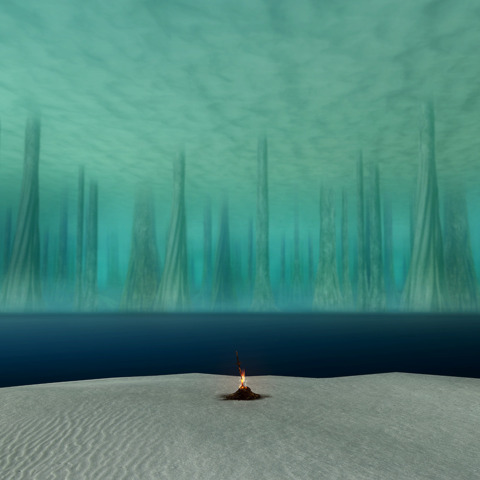

In [63]:
#Recall from last time
import numpy as np
from PIL import Image
import os
img = Image.open("ash-lake.png")
arr = np.asarray(img)
img

images\Red_room.jpeg


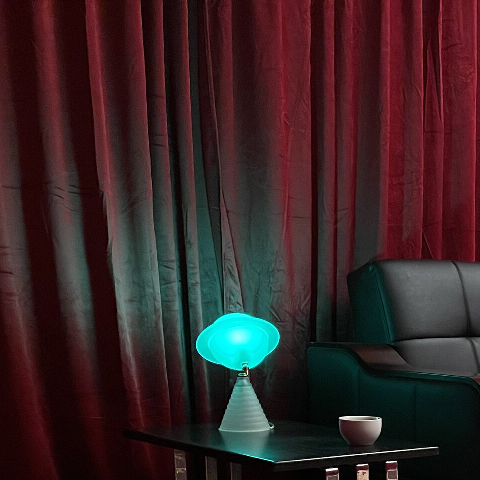

In [64]:
s = os.path.join("images",'Red_room.jpeg')
print(s)
arr_red = np.asarray(Image.open(s))
r_crop_scale_2 = arr_red[:960:2,20:980:2]
Image.fromarray(r_crop_scale_2)

In [65]:
rng = np.random.default_rng()
dis_rng = rng.integers(0,2,[480,480,1], dtype=np.uint8)  #remember that the max, 2, is excluded, so we only get 0 and 1.
print(dis_rng)
arr_dis = arr*dis_rng  #the 1's in dis_rng determine which pixels in Ash Lake are kept.
r_dis = (1-dis_rng)*r_crop_scale_2 #the 0's in dis_rng become 1's in 1-dis_rng, and therefore the opposite pixels from The Red Room are kept.

[[[0]
  [1]
  [0]
  ...
  [0]
  [0]
  [1]]

 [[0]
  [1]
  [1]
  ...
  [0]
  [1]
  [1]]

 [[1]
  [1]
  [0]
  ...
  [1]
  [1]
  [0]]

 ...

 [[0]
  [0]
  [0]
  ...
  [0]
  [0]
  [0]]

 [[1]
  [0]
  [1]
  ...
  [0]
  [0]
  [0]]

 [[0]
  [1]
  [0]
  ...
  [1]
  [1]
  [0]]]


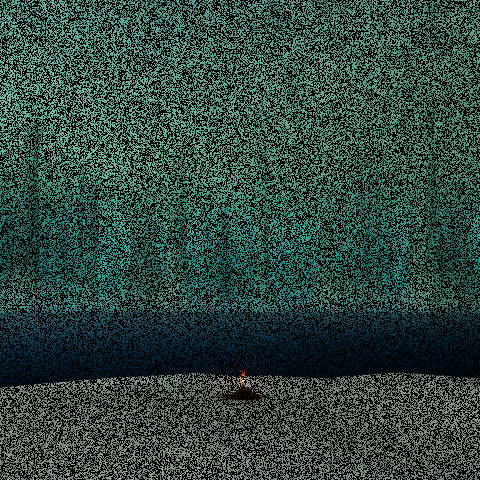

In [66]:
Image.fromarray(arr_dis)

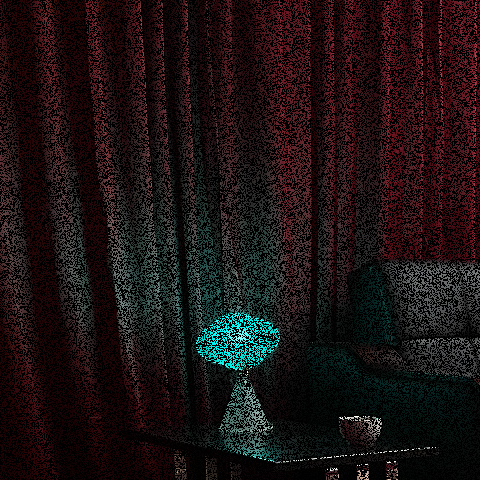

In [67]:
Image.fromarray(r_dis)

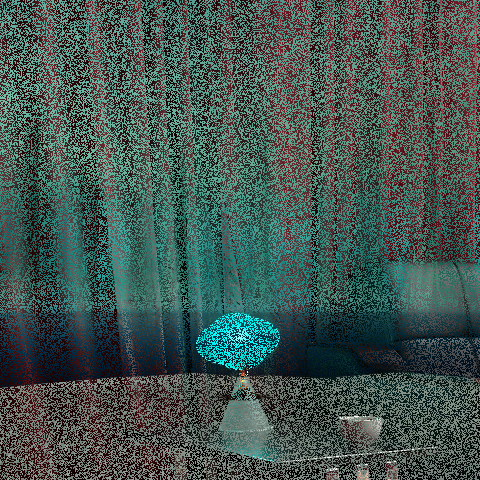

In [68]:
Image.fromarray(arr_dis + r_dis)

In [69]:
img = Image.open("ash-lake.png")
arr = np.asarray(img)

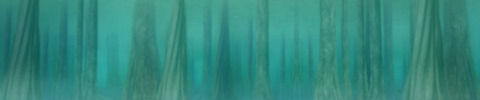

In [70]:
Image.fromarray(arr[200:300])

In [71]:
arr[200:300] = 0

ValueError: assignment destination is read-only

In [72]:
B = arr.copy()

In [73]:
import sys

In [74]:
sys.getsizeof(img)

48

In [75]:
sys.getsizeof(arr)

144

In [76]:
sys.getsizeof(B)

691344

In [77]:
a = np.zeros((1000,1000))   #to compare how sizing works

In [78]:
b = a

In [79]:
sys.getsizeof(a)  #big array requires a larger size

8000128

In [80]:
sys.getsizeof(b) #b is a reference to a, but a is already large

8000128

In [81]:
B[200:300] = 0

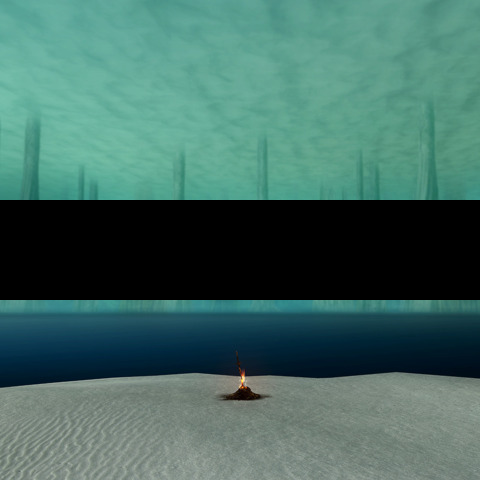

In [82]:
Image.fromarray(B)

In [83]:
B[200:300] = 255

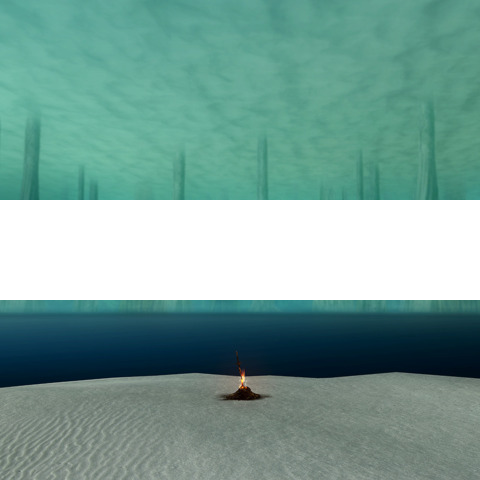

In [84]:
Image.fromarray(B)

In [85]:
colors = np.array([83, 161, 148])

In [86]:
B[200:300].shape

(100, 480, 3)

In [87]:
colors.shape

(3,)

In [88]:
B[200:300] = colors

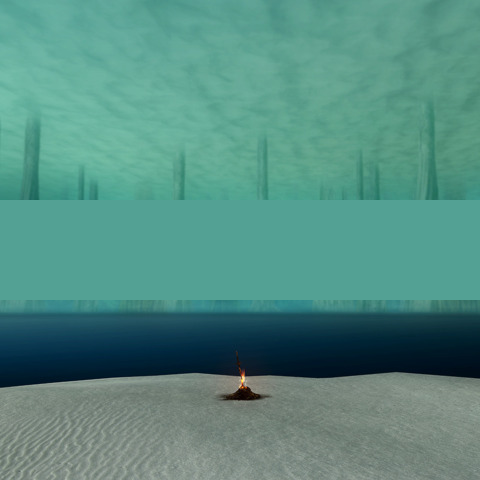

In [89]:
Image.fromarray(B)

In [90]:
B[200:300] = np.array([170, 204, 230])

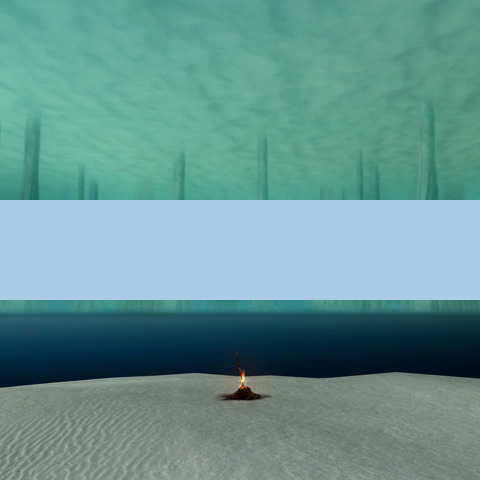

In [91]:
Image.fromarray(B)

In [92]:
arr = np.array([[[255,0,0],[0,255,0]],[[0,0,255],[255,255,0]]])

In [93]:
Image.fromarray(arr)

TypeError: Cannot handle this data type: (1, 1, 3), <i4

In [94]:
arr = np.array([[[255,0,0],[0,255,0]],[[0,0,255],[255,255,0]]],dtype=np.uint8)

In [95]:
img = Image.fromarray(arr)

In [96]:
img

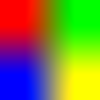

In [97]:
img.resize((100,100))

In [98]:
help(img.resize)

Help on method resize in module PIL.Image:

resize(size: 'tuple[int, int]', resample: 'int | None' = None, box: 'tuple[float, float, float, float] | None' = None, reducing_gap: 'float | None' = None) -> 'Image' method of PIL.Image.Image instance
    Returns a resized copy of this image.

    :param size: The requested size in pixels, as a 2-tuple:
       (width, height).
    :param resample: An optional resampling filter.  This can be
       one of :py:data:`Resampling.NEAREST`, :py:data:`Resampling.BOX`,
       :py:data:`Resampling.BILINEAR`, :py:data:`Resampling.HAMMING`,
       :py:data:`Resampling.BICUBIC` or :py:data:`Resampling.LANCZOS`.
       If the image has mode "1" or "P", it is always set to
       :py:data:`Resampling.NEAREST`. If the image mode specifies a number
       of bits, such as "I;16", then the default filter is
       :py:data:`Resampling.NEAREST`. Otherwise, the default filter is
       :py:data:`Resampling.BICUBIC`. See: :ref:`concept-filters`.
    :param box:

In [99]:
dir(Image.Resampling)

['BICUBIC',
 'BILINEAR',
 'BOX',
 'HAMMING',
 'LANCZOS',
 'NEAREST',
 '__abs__',
 '__add__',
 '__and__',
 '__bool__',
 '__ceil__',
 '__class__',
 '__contains__',
 '__delattr__',
 '__dir__',
 '__divmod__',
 '__doc__',
 '__eq__',
 '__float__',
 '__floor__',
 '__floordiv__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__getitem__',
 '__getnewargs__',
 '__getstate__',
 '__gt__',
 '__hash__',
 '__index__',
 '__init__',
 '__init_subclass__',
 '__int__',
 '__invert__',
 '__iter__',
 '__le__',
 '__len__',
 '__lshift__',
 '__lt__',
 '__members__',
 '__mod__',
 '__module__',
 '__mul__',
 '__name__',
 '__ne__',
 '__neg__',
 '__new__',
 '__or__',
 '__pos__',
 '__pow__',
 '__qualname__',
 '__radd__',
 '__rand__',
 '__rdivmod__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__rfloordiv__',
 '__rlshift__',
 '__rmod__',
 '__rmul__',
 '__ror__',
 '__round__',
 '__rpow__',
 '__rrshift__',
 '__rshift__',
 '__rsub__',
 '__rtruediv__',
 '__rxor__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__sub

In [100]:
for s in dir(Image.Resampling):
    if s[0] != '_' and s[0].isupper():
        print(s)

BICUBIC
BILINEAR
BOX
HAMMING
LANCZOS
NEAREST


In [101]:
for s in dir(Image.Resampling):
    if s[0] != '_' and s[0].isupper():
        print(s)
        display(img.resize((100,100),resample=Image.Resampling.s))

BICUBIC


AttributeError: type object 'Resampling' has no attribute 's'

BICUBIC


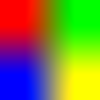

BILINEAR


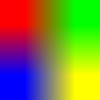

BOX


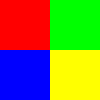

HAMMING


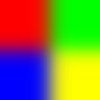

LANCZOS


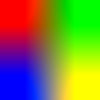

NEAREST


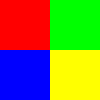

In [102]:
for s in dir(Image.Resampling):
    if s[0] != '_' and s[0].isupper():
        print(s)
        display(img.resize((100,100),resample=getattr(Image.Resampling,s)))

BICUBIC


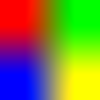

BILINEAR


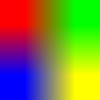

BOX


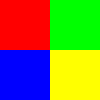

HAMMING


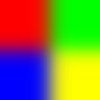

LANCZOS


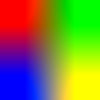

NEAREST


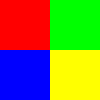

In [103]:
for s in dir(Image.Resampling):
    if s[0] != '_' and s[0].isupper():
        print(s)
        display(img.resize((100,100),resample=Image.Resampling[s]))

In [104]:
import numpy as np
from PIL import Image
import os
img = Image.open("ash-lake.png")
arr = np.asarray(img)

In [105]:
arr

array([[[ 83, 161, 148],
        [ 83, 161, 148],
        [ 83, 161, 148],
        ...,
        [ 94, 157, 140],
        [ 94, 157, 140],
        [ 94, 157, 140]],

       [[ 83, 161, 148],
        [ 83, 161, 148],
        [ 83, 161, 148],
        ...,
        [ 93, 156, 139],
        [ 93, 156, 139],
        [ 93, 156, 139]],

       [[ 83, 161, 148],
        [ 83, 161, 148],
        [ 83, 161, 148],
        ...,
        [ 93, 156, 139],
        [ 92, 155, 138],
        [ 92, 155, 138]],

       ...,

       [[117, 128, 120],
        [140, 151, 143],
        [152, 163, 155],
        ...,
        [113, 126, 119],
        [117, 130, 123],
        [121, 134, 127]],

       [[128, 139, 131],
        [129, 140, 132],
        [124, 135, 127],
        ...,
        [112, 125, 118],
        [114, 127, 120],
        [116, 129, 122]],

       [[130, 141, 133],
        [118, 129, 121],
        [105, 117, 107],
        ...,
        [119, 132, 125],
        [120, 133, 126],
        [121, 134, 127]]

In [106]:
mylist = [ 83, 161, 148]
mylist[0] = mylist[2]  #mylist[0] original value is overwritten
mylist[2] = mylist[0]  #mylist[0] already equals mylist[2], so no change occurs.
mylist

[148, 161, 148]

In [107]:
mylist = [ 83, 161, 148]
temp = mylist[0]
mylist[0] = mylist[2]
mylist[2] = temp
mylist

[148, 161, 83]

In [108]:
B = arr.copy()
temp = B[:,:,0] #Red values; pointing to B - if B changes, so does temp
B[:,:,0] = B[:,:,2]
B[:,:,2] = temp

In [109]:
B[0,0]

array([148, 161, 148], dtype=uint8)

In [110]:
temp2 = B[:,:,0].copy()

In [111]:
sys.getsizeof(temp)

128

In [112]:
sys.getsizeof(temp2)

230528

In [113]:
import numpy as np
from PIL import Image
import os
img = Image.open("ash-lake.png")
arr = np.asarray(img)

In [114]:
#Swaps the Red and Blue Channels
B_rb = arr.copy()
B_rb[:,:,0] = arr[:,:,2]
B_rb[:,:,2] = arr[:,:,0]

In [115]:
B_rb[0,0]

array([148, 161,  83], dtype=uint8)

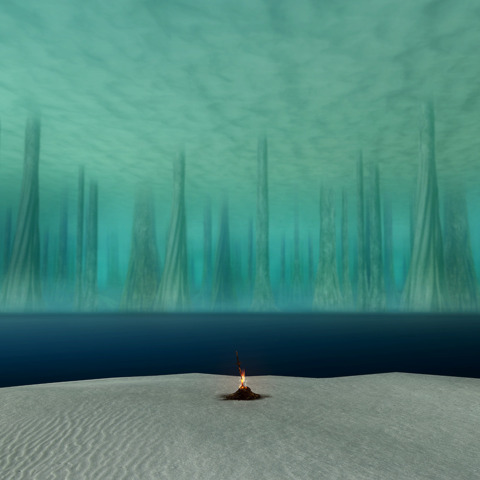

In [116]:
img

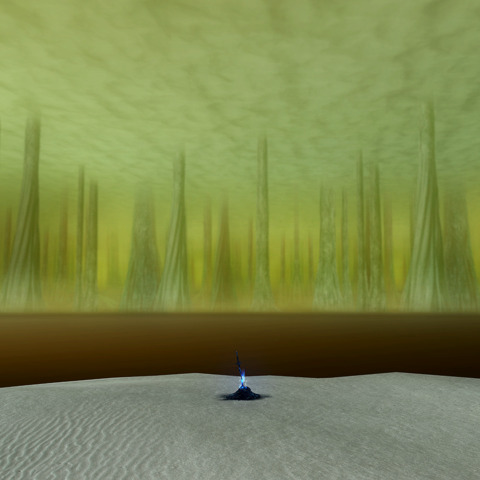

In [117]:
Image.fromarray(B_rb)

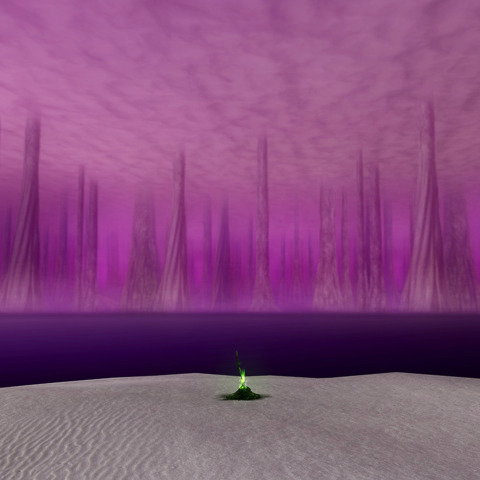

In [118]:
#Swaps the Red and Green Channels
B_rg = arr.copy()
B_rg[:,:,0] = arr[:,:,1]
B_rg[:,:,1] = arr[:,:,0]
Image.fromarray(B_rg)

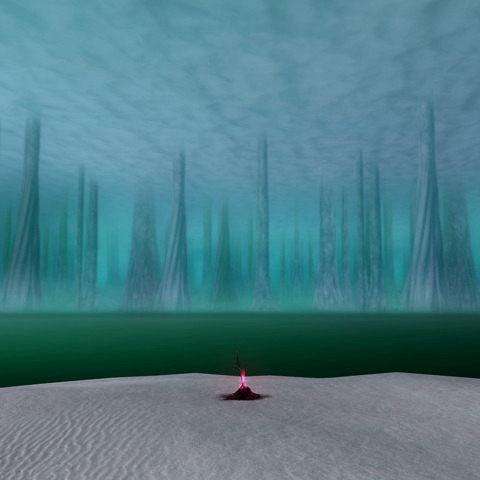

In [119]:
#Swaps the Green and Blue Channels
B_gb = arr.copy()
B_gb[:,:,1] = arr[:,:,2]
B_gb[:,:,2] = arr[:,:,1]
Image.fromarray(B_gb)

In [120]:
import numpy as np
from PIL import Image
import os
img = Image.open("ash-lake.png")
arr = np.asarray(img)

B_rb = arr.copy()
B_rb[:,:,0] = arr[:,:,2]
B_rb[:,:,2] = arr[:,:,0]

B_rg = arr.copy()
B_rg[:,:,0] = arr[:,:,1]
B_rg[:,:,1] = arr[:,:,0]

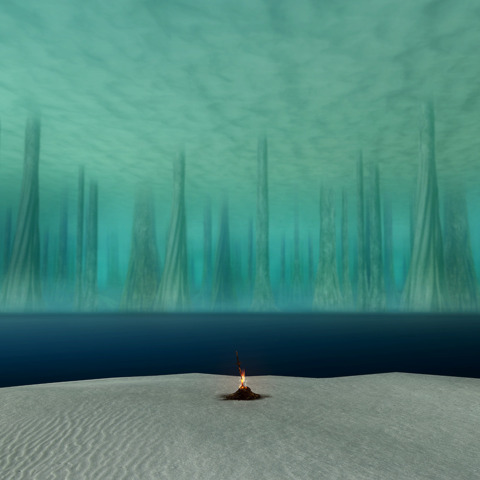

In [121]:
img

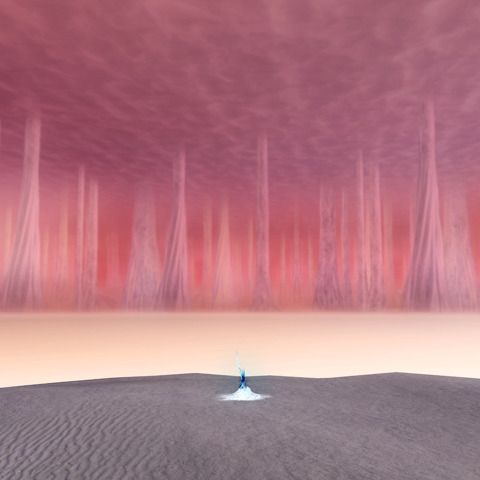

In [122]:
#invert colors, each RGB value is flipped opposite
B_inv = arr.copy()
B_inv = 255-B_inv  
Image.fromarray(B_inv)

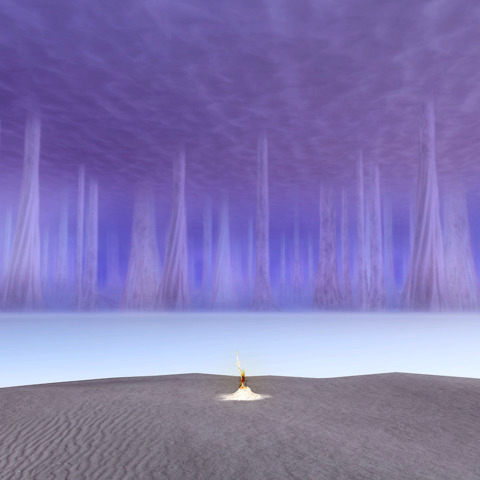

In [123]:
#invert colors on the Red-Blue swap
B_rb_inv = B_rb.copy()
B_rb_inv = 255-B_rb_inv  
Image.fromarray(B_rb_inv)

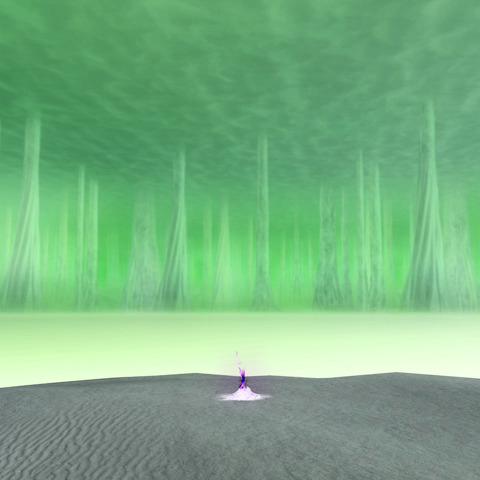

In [124]:
#invert colors on the Red-Green swap
B_rg_inv = B_rg.copy()
B_rg_inv = 255-B_rg_inv  
Image.fromarray(B_rg_inv)

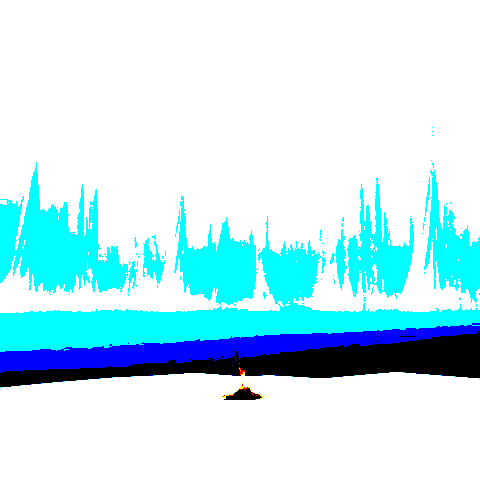

In [125]:
#Threshold filter
B = arr.copy()
B_th = np.empty_like(B)

thresh = 50  #color channels over this value will be increased to the max value. Otherwise, they are 0.
#interesting values for this picture: thresh = 50, 70, 125, 150

for i in range(3): #loop over each color channel
    B_th[:, :, i] = (B[:, :, i] > thresh) * 255

Image.fromarray(B_th)

In [126]:
import numpy as np
from PIL import Image
import os
img = Image.open("ash-lake.png")
arr = np.asarray(img)

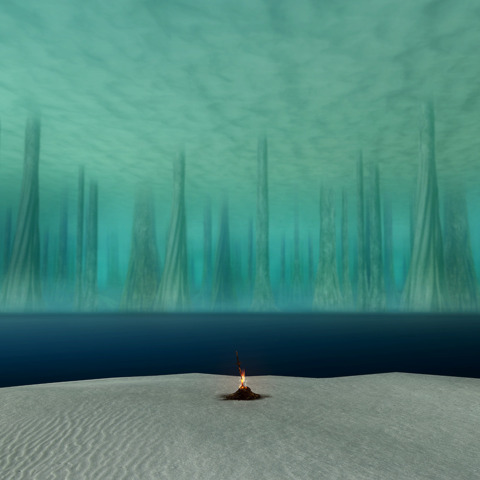

In [127]:
img

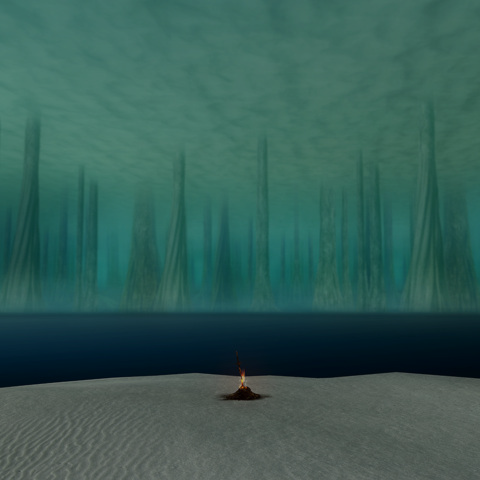

In [128]:
B_dark = arr.copy()

c = 0.7  #Darken, use constant between 0 and 1
B_dark = np.uint8(c*B_dark)  #pixels must be 8-bit integers.
Image.fromarray(B_dark)

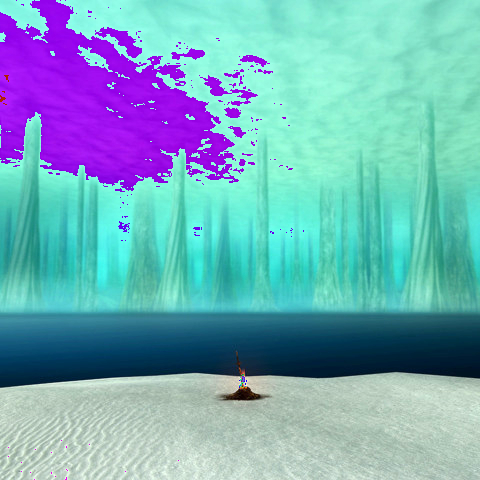

In [129]:
B = arr.copy()

c = 1.5 #Brighten, use constant greater than 1. 
#But too high constant causes some color channels to go above 255.
#c = 5 is gives weird and abstract rainbow colorings
#negative numbers also give weird colorings.
B = np.uint8(c*B)
Image.fromarray(B)

In [130]:
B = np.float64(arr.copy())

c = 3

B = c*B
B  #now we can see what the values are before they roll over.

array([[[249., 483., 444.],
        [249., 483., 444.],
        [249., 483., 444.],
        ...,
        [282., 471., 420.],
        [282., 471., 420.],
        [282., 471., 420.]],

       [[249., 483., 444.],
        [249., 483., 444.],
        [249., 483., 444.],
        ...,
        [279., 468., 417.],
        [279., 468., 417.],
        [279., 468., 417.]],

       [[249., 483., 444.],
        [249., 483., 444.],
        [249., 483., 444.],
        ...,
        [279., 468., 417.],
        [276., 465., 414.],
        [276., 465., 414.]],

       ...,

       [[351., 384., 360.],
        [420., 453., 429.],
        [456., 489., 465.],
        ...,
        [339., 378., 357.],
        [351., 390., 369.],
        [363., 402., 381.]],

       [[384., 417., 393.],
        [387., 420., 396.],
        [372., 405., 381.],
        ...,
        [336., 375., 354.],
        [342., 381., 360.],
        [348., 387., 366.]],

       [[390., 423., 399.],
        [354., 387., 363.],
        [315., 3

In [131]:
B > 255 #find the values that overflow

array([[[False,  True,  True],
        [False,  True,  True],
        [False,  True,  True],
        ...,
        [ True,  True,  True],
        [ True,  True,  True],
        [ True,  True,  True]],

       [[False,  True,  True],
        [False,  True,  True],
        [False,  True,  True],
        ...,
        [ True,  True,  True],
        [ True,  True,  True],
        [ True,  True,  True]],

       [[False,  True,  True],
        [False,  True,  True],
        [False,  True,  True],
        ...,
        [ True,  True,  True],
        [ True,  True,  True],
        [ True,  True,  True]],

       ...,

       [[ True,  True,  True],
        [ True,  True,  True],
        [ True,  True,  True],
        ...,
        [ True,  True,  True],
        [ True,  True,  True],
        [ True,  True,  True]],

       [[ True,  True,  True],
        [ True,  True,  True],
        [ True,  True,  True],
        ...,
        [ True,  True,  True],
        [ True,  True,  True],
        [ True,

In [132]:
255*(B>255) #True counts as 1, False counts as 0, so we multiply by 255

array([[[  0, 255, 255],
        [  0, 255, 255],
        [  0, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[  0, 255, 255],
        [  0, 255, 255],
        [  0, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[  0, 255, 255],
        [  0, 255, 255],
        [  0, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]

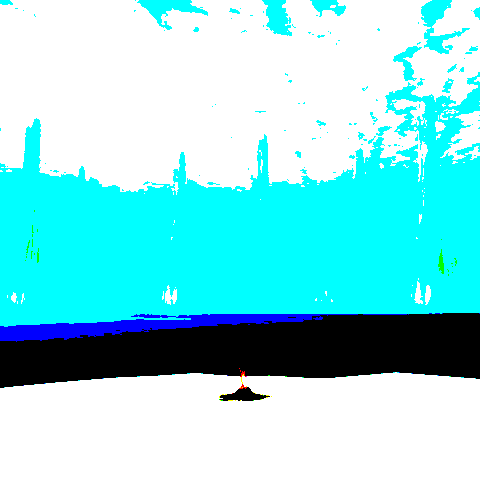

In [133]:
Image.fromarray(np.uint8(255*(B > 255)))   #visualize all of the color channels that overflow, for fun. 

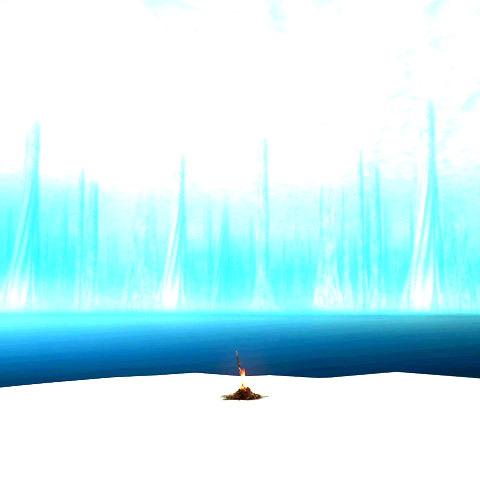

In [134]:
B[B > 255] = 255
Image.fromarray(np.uint8(B)) #The final result

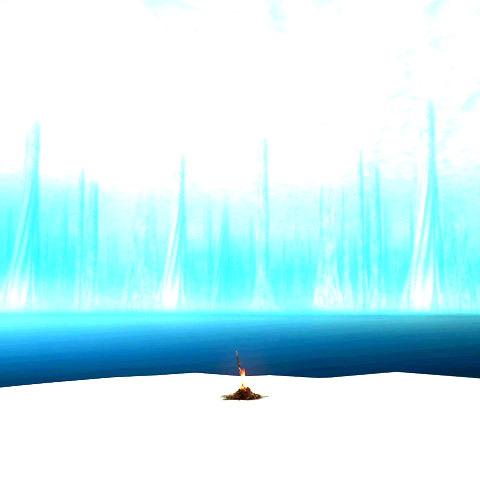

In [135]:
#All in one cell
L = np.float64(arr.copy())
c = 3
L = c*L
L[L > 255] = 255
Image.fromarray(np.uint8(L)) #The final result
#Note: There are smarter brightness algorithms than this.

In [136]:
gray_range = np.arange(0,256).reshape(16,16)

In [137]:
img_gr = Image.fromarray(np.uint8(gray_range))
img_gr

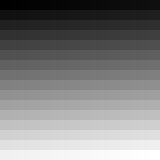

In [138]:
n = 10
Expander = np.ones((n,n))
big_gr = np.kron(gray_range, Expander)  #each single number in gray_range is expanded to an nxn block of all the same value
Image.fromarray(np.uint8(big_gr))

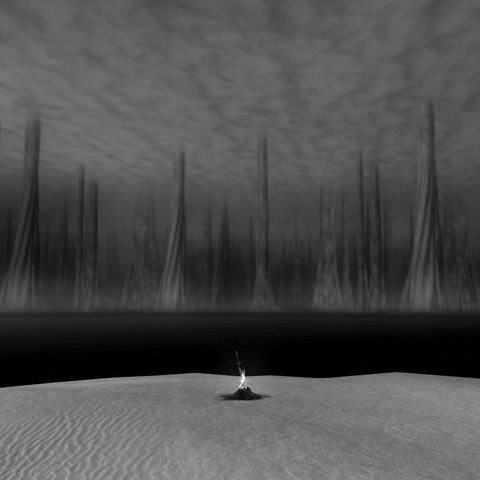

In [139]:
B = arr[:,:,0].copy()    #red channel
#B = arr[:,:,1].copy()    #green channel
#B = arr[:,:,2].copy()    #blue channel
B = np.uint8(B)
Image.fromarray(B)

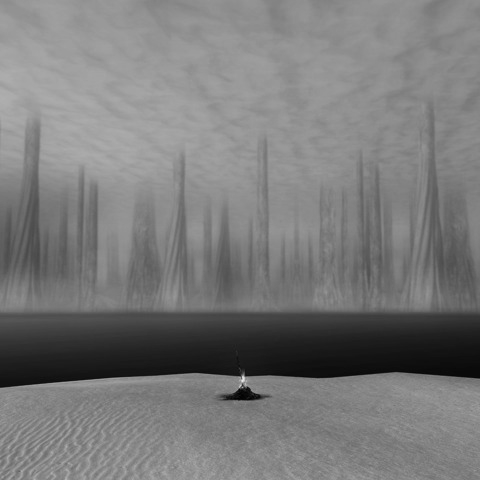

In [140]:
Y = arr.copy()
Y_bettergray = np.uint8(0.2125*Y[:,:,0] + 0.7154*Y[:,:,1] + 0.0721*Y[:,:,2])
Image.fromarray(Y_bettergray)

In [141]:
Y_bettergray.shape

(480, 480)

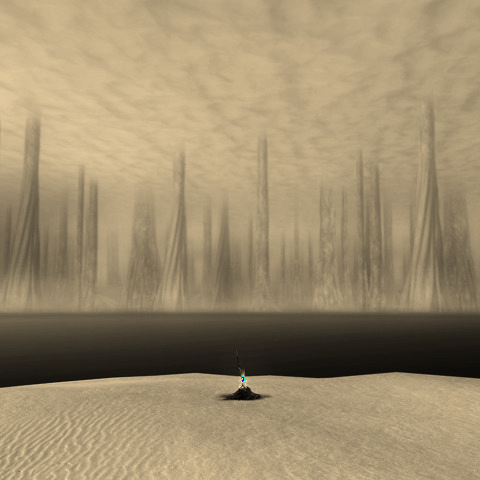

In [142]:
S = arr.copy()
S_sepia = np.zeros_like(S)
S_sepia[:,:,0] = 0.393*S[:,:,0] + 0.769*S[:,:,1] + 0.189*S[:,:,2]
S_sepia[:,:,1] = 0.349*S[:,:,0] + 0.686*S[:,:,1] + 0.168*S[:,:,2]
S_sepia[:,:,2] = 0.272*S[:,:,0] + 0.534*S[:,:,1] + 0.131*S[:,:,2]

Image.fromarray(np.uint8(S_sepia))

In [143]:
S_sepia.shape

(480, 480, 3)

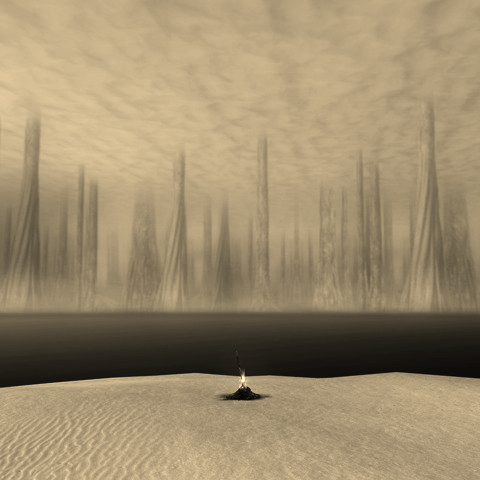

In [144]:
S_sepia = np.float64(np.zeros_like(S))
S_sepia[:,:,0] = 0.393*S[:,:,0] + 0.769*S[:,:,1] + 0.189*S[:,:,2]
S_sepia[:,:,1] = 0.349*S[:,:,0] + 0.686*S[:,:,1] + 0.168*S[:,:,2]
S_sepia[:,:,2] = 0.272*S[:,:,0] + 0.534*S[:,:,1] + 0.131*S[:,:,2]

S_sepia[S_sepia > 255] = 255
Image.fromarray(np.uint8(S_sepia))

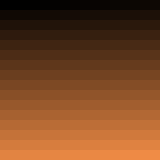

In [145]:
color1 = [0,0,0]  #black                 
color2 = [240,140,70]  #orange              

#color1 = [255,255,255]  #white 
#color2 = [240,140,70]   #orange

#color1 = [220, 190, 0] #gold
#color2 = [0, 0, 250] #blue

Duo_gradient = np.zeros((256, 3))

for i in range(3):
    Duo_gradient[:, i] = np.linspace(color1[i], color2[i], 256)

Grad_view = Duo_gradient.reshape(16,16,3)

display(Image.fromarray(np.uint8(Grad_view)))

n = 10
Expander = np.ones((n,n))
big_grad = np.zeros((n*16, n*16, 3))
for i in range(3):
    big_grad[:,:,i] = np.kron(Grad_view[:,:,i], Expander)
Image.fromarray(np.uint8(big_grad))


(480, 480, 3)


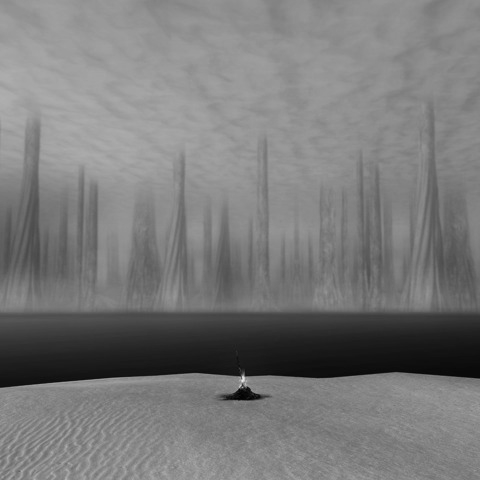

In [146]:
D = arr.copy()
D_gray = 0.2125*D[:,:,0] + 0.7154*D[:,:,1] + 0.0721*D[:,:,2]
D_gray = D_gray.reshape(D.shape[0],D.shape[1],1)
D[:,:,:] = D_gray
print(D.shape)
Image.fromarray(np.uint8(D))

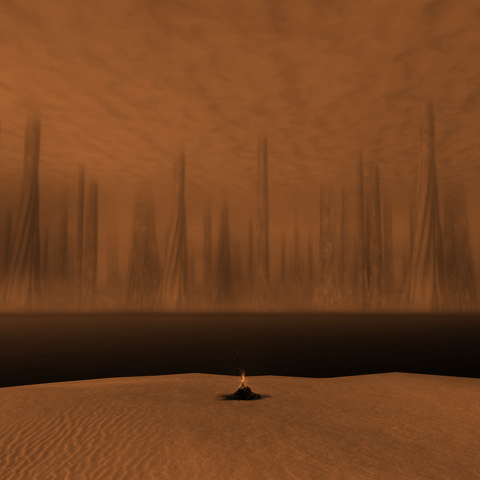

In [147]:
Du = D.copy()
for channel in range(3):
    Mask = np.ones_like(D_gray).reshape(D.shape[0],D.shape[1])
    for color in range(Du.min(), Du.max()+1):
        #print(f"Channel = {channel}, color = {color}, number of matches not previously covered = {sum(sum((Du[:,:,channel] == color) & (Mask == 1)))}")
        Mask[(Mask == 1) & (Du[:,:,channel] == color)] = 2
        Du[:,:,channel][(Du[:,:,channel] == color) & (Mask == 2)] = Duo_gradient[color,channel]
        Mask[Mask == 2] = 0

Image.fromarray(np.uint8(Du))

In [148]:
rng = np.random.default_rng()
R = rng.integers(0,255,[100,700])

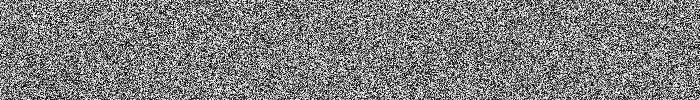

In [149]:
Image.fromarray(np.uint8(R))

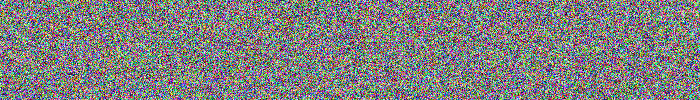

In [150]:
R_color = rng.integers(0,255,[100,700,3])
Image.fromarray(np.uint8(R_color))

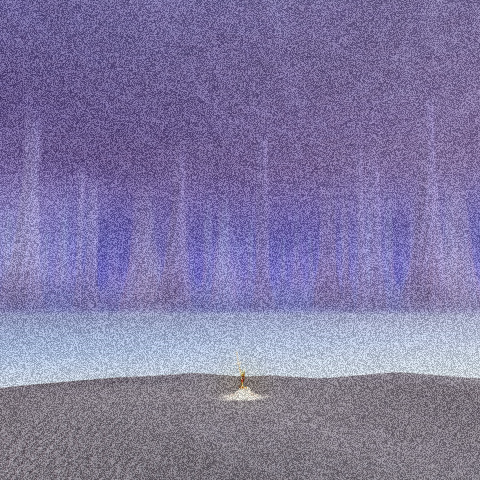

In [151]:
R2 = rng.integers(0,255,(480,480,1))
weight = 0.3
Image.fromarray(np.uint8((1-weight)*(B_rb_inv) + weight*(R2)))  #Weight the two images together, like in the example earlier in this notebook.

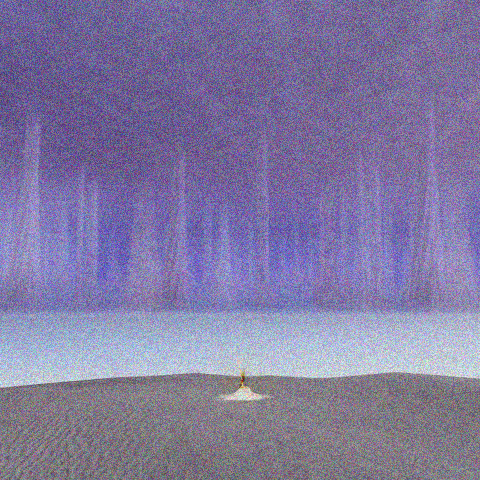

In [152]:
R_color2 = rng.integers(0,255,arr.shape)  #get the size of the random array from the image array
weight = 0.3
Image.fromarray(np.uint8((1-weight)*(B_rb_inv) + weight*(R_color2)))  #Weight the two images together, like in the example earlier in this notebook.

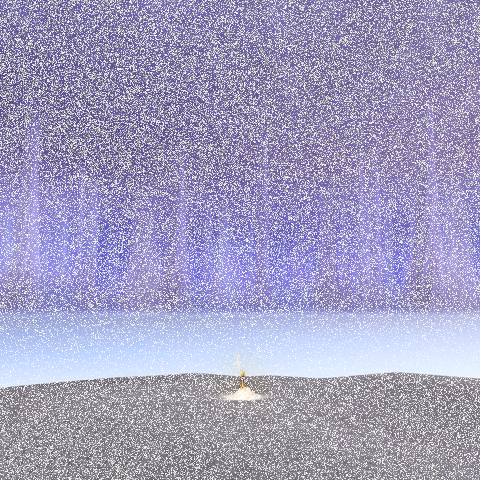

In [153]:
Image.fromarray(np.uint8(np.maximum(R2, B_rb_inv)))  #note np.maximum is different from np.max!
#np.maximum compares 2 arrays component-wise and returns the largest values
#np.max finds the single largest element in one array (or along an axis, depending on your inputs)

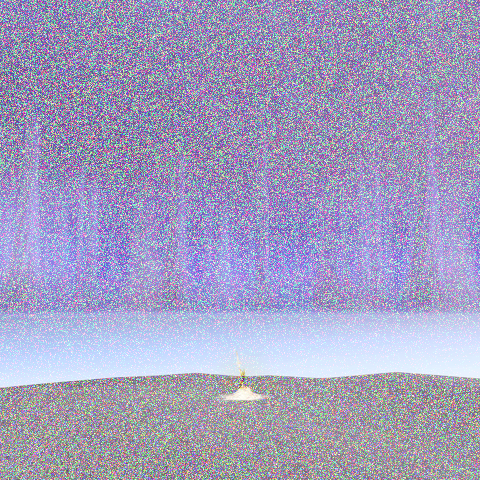

In [154]:
Image.fromarray(np.uint8(np.maximum(R_color2, B_rb_inv)))  #note np.maximum is different from np.max!
#np.maximum compares 2 arrays component-wise and returns the largest values
#np.max finds the single largest element in one array (or along an axis, depending on your inputs)

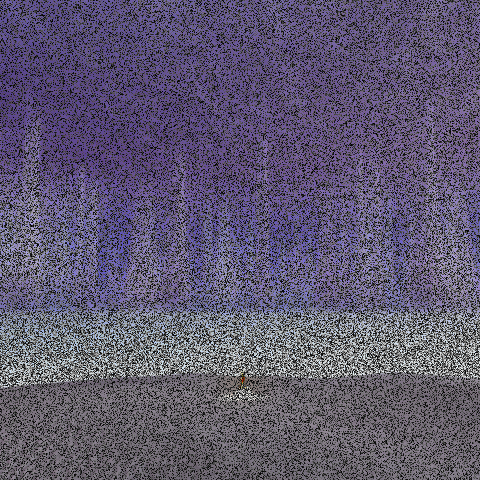

In [155]:
Image.fromarray(np.uint8(np.minimum(R2, B_rb_inv)))  #note np.maximum is different from np.max!
#np.maximum compares 2 arrays component-wise and returns the largest values
#np.max finds the single largest element in one array (or along an axis, depending on your inputs)

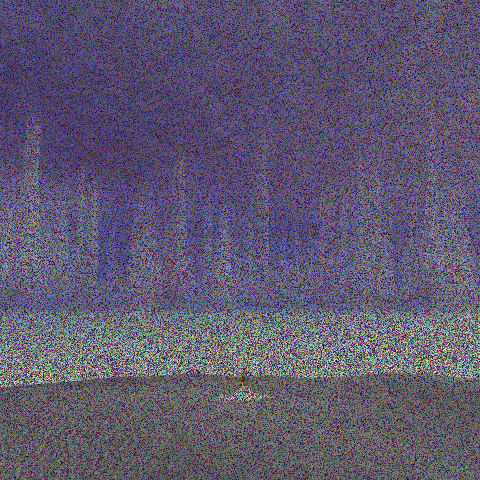

In [156]:
Image.fromarray(np.uint8(np.minimum(R_color2, B_rb_inv)))  #note np.maximum is different from np.max!
#np.maximum compares 2 arrays component-wise and returns the largest values
#np.max finds the single largest element in one array (or along an axis, depending on your inputs)

images\Cloud.png


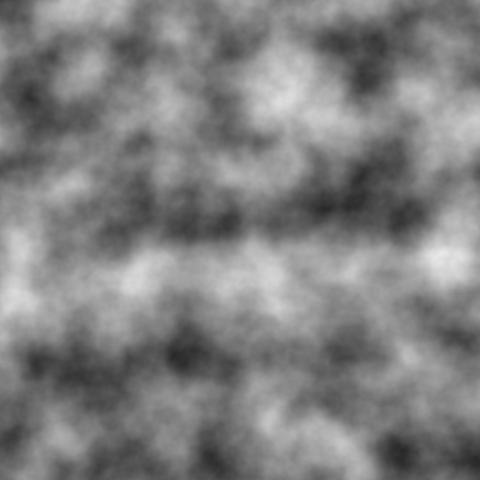

In [157]:
s = os.path.join("images",'Cloud.png')
print(s)
img = Image.open(s)
arr_c = np.zeros((480,480,3))
arr_c[:,:,:] = np.asarray(img).reshape(480,480,1)
display(img)

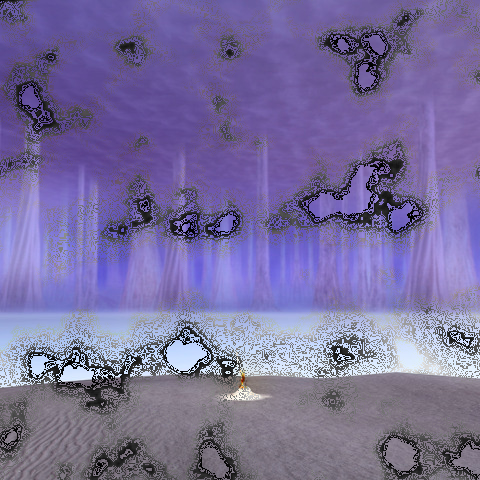

In [158]:
Image.fromarray(np.uint8(np.minimum(5*arr_c, B_rb_inv)))

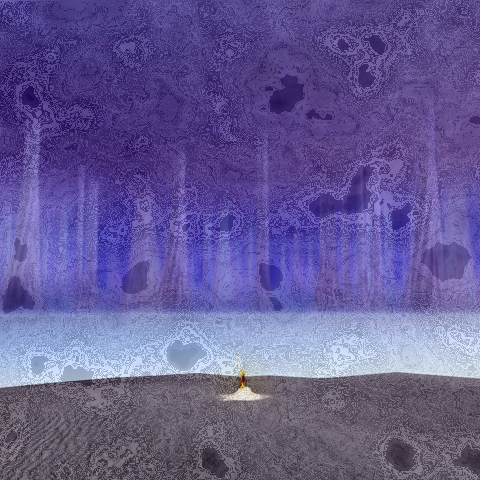

In [159]:
weight = 0.4
B_diff = np.abs(np.float64(B_rb_inv) - np.float64(weight*arr_c))
Image.fromarray(np.uint8(B_diff))

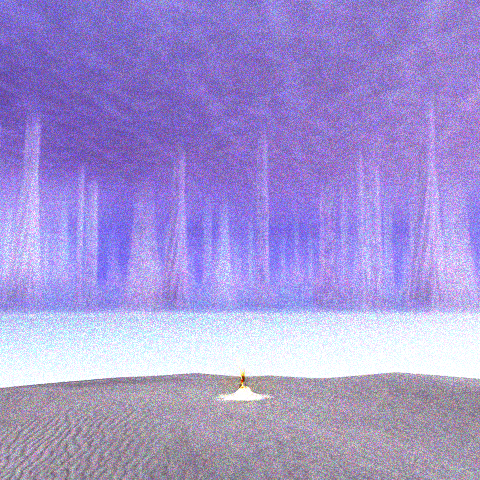

In [160]:
weight = 0.4 #lower the intensity of the noise
B_cd = (np.float64(B_rb_inv)/255)/(1 - (weight*np.float64(R_color2)/255))
B_cd *= 255
B_cd[B_cd > 255] = 255
Image.fromarray(np.uint8(B_cd))

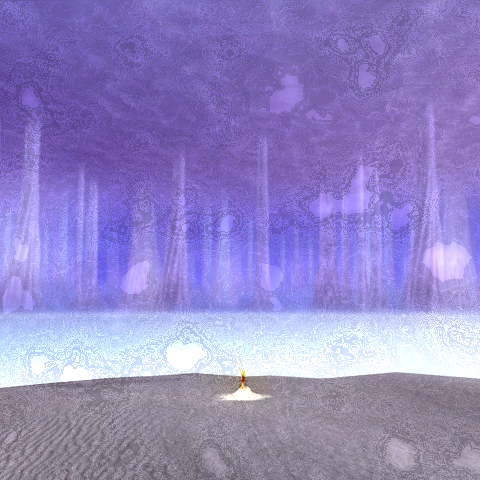

In [161]:
weight = 0.4 #lower the intensity of the noise
B_cd = (np.float64(B_rb_inv)/255)/(1 - (weight*np.float64(arr_c)/255))
B_cd *= 255
B_cd[B_cd > 255] = 255
Image.fromarray(np.uint8(B_cd))

C:\Users\lukea\AppData\Local\Temp\ipykernel_18492\1410203081.py:2: RuntimeWarning: divide by zero encountered in divide
  B_cd = 1- (1 - np.float64(B_rb_inv)/255)/((weight*np.float64(R_color2)/255))
C:\Users\lukea\AppData\Local\Temp\ipykernel_18492\1410203081.py:2: RuntimeWarning: invalid value encountered in divide
  B_cd = 1- (1 - np.float64(B_rb_inv)/255)/((weight*np.float64(R_color2)/255))
C:\Users\lukea\AppData\Local\Temp\ipykernel_18492\1410203081.py:6: RuntimeWarning: invalid value encountered in cast
  Image.fromarray(np.uint8(B_cd))


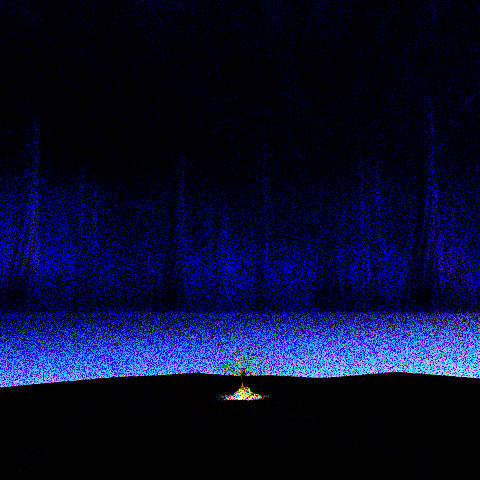

In [162]:
weight = 0.5 #lower the intensity of the noise
B_cd = 1- (1 - np.float64(B_rb_inv)/255)/((weight*np.float64(R_color2)/255))
B_cd *= 255
B_cd[B_cd > 255] = 255
B_cd[B_cd < 0] = 0
Image.fromarray(np.uint8(B_cd))

C:\Users\lukea\AppData\Local\Temp\ipykernel_18492\1222757672.py:2: RuntimeWarning: divide by zero encountered in divide
  B_cd = 1 - (1 - np.float64(B_rb_inv)/255)/((weight*np.float64(arr_c)/255))
C:\Users\lukea\AppData\Local\Temp\ipykernel_18492\1222757672.py:2: RuntimeWarning: invalid value encountered in divide
  B_cd = 1 - (1 - np.float64(B_rb_inv)/255)/((weight*np.float64(arr_c)/255))
C:\Users\lukea\AppData\Local\Temp\ipykernel_18492\1222757672.py:6: RuntimeWarning: invalid value encountered in cast
  Image.fromarray(np.uint8(B_cd))


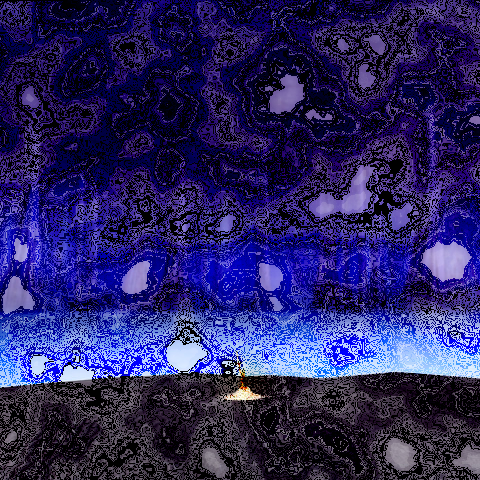

In [163]:
weight = 1.75
B_cd = 1 - (1 - np.float64(B_rb_inv)/255)/((weight*np.float64(arr_c)/255))
B_cd *= 255
B_cd[B_cd > 255] = 255
B_cd[B_cd < 0] = 0
Image.fromarray(np.uint8(B_cd))